<a href="https://colab.research.google.com/github/ChiomaUU/CMPT2400/blob/main/2400EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Loading and previewing Data

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.impute import SimpleImputer
from sklearn.ensemble import RandomForestRegressor
import statsmodels.api as sm
from prophet import Prophet



In [ ]:
# Load the dataset, specifying the encoding as 'latin-1'
df = pd.read_csv('NPRI_2000-2022.csv', encoding='latin-1')

#Setting up notebook so that all columns are displayed
pd.set_option('display.max_columns', None)

# Preview the dataset
df.head()

,Reporting_Year / Année,NPRI_ID / No_INRP,Number of employees,Company_Name / Dénomination_sociale_de_l'entreprise,Facility_Name / Installation,NAICS / Code_SCIAN,NAICS Title / Titre Code_SCIAN,PROVINCE,City,Latitude,Longitude,CAS_Number / No_CAS,Substance Name (English) / Nom de substance (Anglais),Units / Unités,Estimation_Method / Méthode_destimation,Release to Air - Fugitive,Release to Air - Other Non-Point,Release to Air - Road dust,Release to Air - Spills,Release to Air - Stack / Point,Release to Air - Storage / Handling,Releases to Land - Leaks,Releases to Land - Other,Releases to Land - Spills,Releases to Water Bodies - Direct Discharges,Releases to Water Bodies - Leaks,Releases to Water Bodies - Spills,Sum of release to all media (<1tonne)
0,2000,1,440.0,Alberta-Pacific Forest Industries Inc.,(blank),322112.0,Chemical pulp mills,AB,County of Athabasca,54.923116,-112.861867,10049-04-4,Chlorine dioxide,tonnes,M - Monitoring or Direct Measurement,NaN,NaN,NaN,NaN,5.200,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2000,1,440.0,Alberta-Pacific Forest Industries Inc.,(blank),322112.0,Chemical pulp mills,AB,County of Athabasca,54.923116,-112.861867,67-56-1,Methanol,tonnes,E - Emission Factor,NaN,NaN,NaN,NaN,113.000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2000,1,440.0,Alberta-Pacific Forest Industries Inc.,(blank),322112.0,Chemical pulp mills,AB,County of Athabasca,54.923116,-112.861867,67-66-3,Chloroform,tonnes,M - Monitoring or Direct Measurement,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN
3,2000,1,440.0,Alberta-Pacific Forest Industries Inc.,(blank),322112.0,Chemical pulp mills,AB,County of Athabasca,54.923116,-112.861867,75-07-0,Acetaldehyde,tonnes,E - Emission Factor,NaN,NaN,NaN,NaN,7.670,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2000,1,440.0,Alberta-Pacific Forest Industries Inc.,(blank),322112.0,Chemical pulp mills,AB,County of Athabasca,54.923116,-112.861867,7647-01-0,Hydrochloric acid,tonnes,M - Monitoring or Direct Measurement,NaN,NaN,NaN,NaN,0.665,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df.shape

(737516, 28)

In [ ]:
#showing all the attributes in the data
df.columns

Index(['Reporting_Year / Année', 'NPRI_ID / No_INRP', 'Number of employees',
       'Company_Name / Dénomination_sociale_de_l'entreprise',
       'Facility_Name / Installation', 'NAICS / Code_SCIAN',
       'NAICS Title / Titre Code_SCIAN', 'PROVINCE', 'City', 'Latitude',
       'Longitude', 'CAS_Number / No_CAS',
       'Substance Name (English) / Nom de substance (Anglais)',
       'Units / Unités', 'Estimation_Method / Méthode_destimation',
       'Release to Air - Fugitive', 'Release to Air - Other Non-Point ',
       'Release to Air - Road dust  ', 'Release to Air - Spills ',
       'Release to Air - Stack / Point  ',
       'Release to Air - Storage / Handling ', 'Releases to Land - Leaks',
       'Releases to Land - Other ', 'Releases to Land - Spills ',
       'Releases to Water Bodies - Direct Discharges ',
       'Releases to Water Bodies - Leaks',
       'Releases to Water Bodies - Spills ',
       'Sum of release to all media (<1tonne)'],
      dtype='object')

In [ ]:
#Check data types, missing values, and basic statistics
df.info()  # Check data types and missing values
df.describe()  # Get summary statistics of numerical columns


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 737516 entries, 0 to 737515
Data columns (total 28 columns):
 #   Column                                                 Non-Null Count   Dtype  
---  ------                                                 --------------   -----  
 0   Reporting_Year / Année                                 737516 non-null  int64  
 1   NPRI_ID / No_INRP                                      737516 non-null  int64  
 2   Number of employees                                    736900 non-null  object 
 3   Company_Name / Dénomination_sociale_de_l'entreprise    737516 non-null  object 
 4   Facility_Name / Installation                           736340 non-null  object 
 5   NAICS / Code_SCIAN                                     737516 non-null  int64  
 6   NAICS Title / Titre Code_SCIAN                         737516 non-null  object 
 7   PROVINCE                                               737516 non-null  object 
 8   City                              

,Reporting_Year / Année,NPRI_ID / No_INRP,NAICS / Code_SCIAN,Latitude,Longitude,Release to Air - Fugitive,Release to Air - Other Non-Point,Release to Air - Road dust,Release to Air - Spills,Release to Air - Stack / Point,Release to Air - Storage / Handling,Releases to Land - Leaks,Releases to Land - Other,Releases to Land - Spills,Releases to Water Bodies - Direct Discharges,Releases to Water Bodies - Leaks,Releases to Water Bodies - Spills,Sum of release to all media (<1tonne)
count,737516.000000,737516.000000,737516.000000,733434.000000,733434.000000,125032.000000,30880.000000,29861.000000,9181.000000,513282.000000,80004.000000,910.000000,5668.000000,4470.000000,53188.000000,742.000000,3080.000000,50185.000000
mean,2012.267601,11248.268386,289175.551820,49.644636,-97.375436,61.156824,91.455034,117.236013,1.742604,144.203321,23.462437,0.356315,515.614162,5.090716,79.052084,0.710053,174.901856,0.141082
std,6.400156,9352.868266,94788.542197,5.155658,20.184399,797.572502,1628.905004,856.012131,22.223163,2014.861249,218.305058,2.586239,3181.280880,93.378082,577.693253,5.332891,5342.398935,2.606306
min,2000.000000,1.000000,111120.000000,0.000000,-140.883600,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2007.000000,3775.000000,211113.000000,45.431000,-114.767700,0.051000,0.013000,0.505400,0.000000,0.429000,0.015000,0.000000,0.001000,0.000000,0.060000,0.000000,0.000000,0.001700
50%,2012.000000,7114.000000,312140.000000,49.795100,-104.630100,0.796000,0.490000,3.561900,0.000300,4.037595,0.358000,0.000000,5.000000,0.002000,2.068000,0.000000,0.087900,0.023700
75%,2018.000000,18093.000000,327120.000000,53.508500,-79.540060,7.582000,7.458500,22.000000,0.040000,37.389000,3.953000,0.000000,47.000000,0.030000,20.578400,0.000000,1.398350,0.150000
max,2022.000000,306556.000000,913910.000000,82.498758,0.000000,58433.900000,91138.200000,39992.961050,1554.400000,235907.000000,17883.110000,39.058000,152270.000000,4500.100000,39991.000000,82.400000,259050.000000,582.000000


In [ ]:
#Check for duplicates
print(f"Number of duplicate rows: {df.duplicated().sum()}")  #Count duplicates

Number of duplicate rows: 0


In [ ]:
df.shape

(737516, 28)

In [ ]:
#Check for missing values
missing_values = df.isnull().sum()
missing_values[missing_values > 0]  # Display columns with missing values


,0
Number of employees,616
Facility_Name / Installation,1176
City,90764
Latitude,4082
Longitude,4082
Release to Air - Fugitive,612484
Release to Air - Other Non-Point,706636
Release to Air - Road dust,707655
Release to Air - Spills,728335
Release to Air - Stack / Point,224234


In [ ]:
!pip install ydata-profiling
from ydata_profiling import ProfileReport

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 356.2/356.2 kB 13.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 17.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 31.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 9.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 61.7 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=281e236a66e30056fbdf8117c3560478b32b4e2c4cd571333c303fe2852973c0
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin


In [ ]:
profile = ProfileReport(df, title="NPRI Profiling Report", explorative=True)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

#Handling missing values

In [ ]:
df['Number of employees'] = pd.to_numeric(df['Number of employees'], errors='coerce')
df['Number of employees'] = df['Number of employees'].fillna(df['Number of employees'].median())

In [ ]:
df['Facility_Name / Installation'] = df['Facility_Name / Installation'].fillna('Unknown')


In [ ]:
df['City'] = df['City'].fillna(df['City'].mode()[0])


In [ ]:
# Impute missing lat/lon by city mean
df['Latitude'] = df.groupby('City')['Latitude'].transform(lambda x: x.fillna(x.mean()))
df['Longitude'] = df.groupby('City')['Longitude'].transform(lambda x: x.fillna(x.mean()))



In [ ]:
# Impute missing values with zero for pollutant releases
release_cols = ['Release to Air - Fugitive','Release to Air - Other Non-Point ',
       'Release to Air - Road dust  ','Release to Air - Spills ',
       'Release to Air - Stack / Point  ',
       'Release to Air - Storage / Handling ','Releases to Land - Leaks',
       'Releases to Land - Other ','Releases to Land - Spills ',
       'Releases to Water Bodies - Direct Discharges ',
       'Releases to Water Bodies - Leaks',
       'Releases to Water Bodies - Spills ',]


df[release_cols] = df[release_cols].fillna(0)

In [ ]:
# Impute with the sum of other release columns if applicable, else fill with zero
df['Sum of release to all media (<1tonne)'] = df[release_cols].sum(axis=1)
df['Sum of release to all media (<1tonne)'] = df['Sum of release to all media (<1tonne)'].fillna(0)


In [ ]:
# Final check for missing values
missing_values = df.isnull().sum()
missing_values[missing_values > 0]  # Show columns with remaining missing values


,0


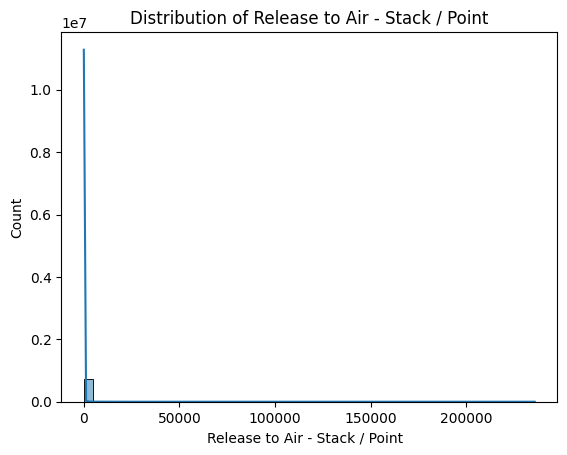

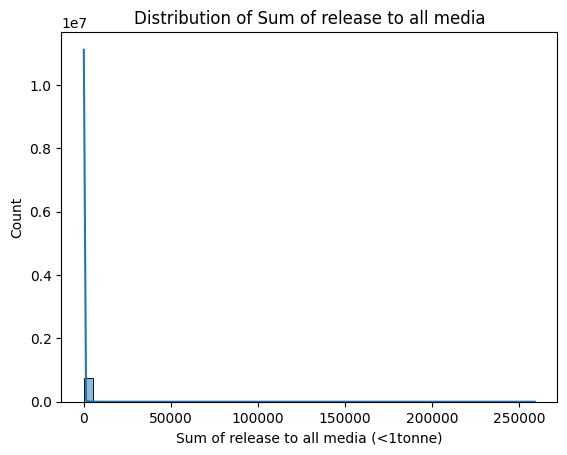

In [ ]:
#Plot distributions
sns.histplot(df['Release to Air - Stack / Point  '], bins=50, kde=True)
plt.title('Distribution of Release to Air - Stack / Point')
plt.show()

sns.histplot(df['Sum of release to all media (<1tonne)'], bins=50, kde=True)
plt.title('Distribution of Sum of release to all media')
plt.show()


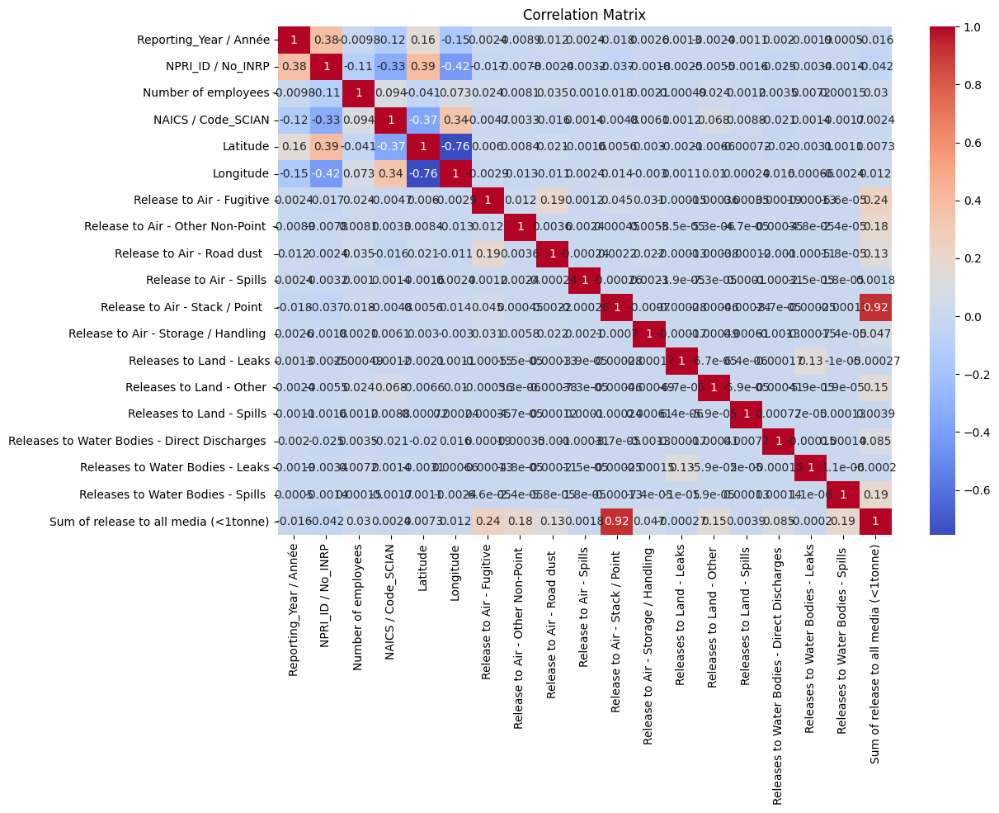

In [ ]:
#Correlation matrix
corr_matrix = df.select_dtypes(include=np.number).corr() # Select only numerical columns for correlation calculation
plt.figure(figsize=(12,8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()

In [ ]:
#Identify and handle outliers using z-scores
from scipy import stats

z_scores = np.abs(stats.zscore(df['Sum of release to all media (<1tonne)']))
outliers = np.where(z_scores > 3)

In [ ]:
df_cleaned = df.drop(outliers[0])  # Remove rows with extreme outliers

In [ ]:
#Normalize 'Sum of release to all media' feature
scaler = MinMaxScaler()
df['Sum of release to all media (<1tonne)'] = scaler.fit_transform(df[['Sum of release to all media (<1tonne)']])


In [ ]:
#Plot releases on a geographic map (requires geopandas and folium)
import folium

# Create a map centered around a specific location (e.g., Canada)
map = folium.Map(location=[56.1304, -106.3468], zoom_start=4)

# Add points to the map
for index, row in df.iterrows():
    folium.CircleMarker([row['Latitude'], row['Longitude']], radius=5, color='red').add_to(map)

# Display the map
map


KeyboardInterrupt: 

#Predictive Modeling for 2023

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 17.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpgfg4_8ye/lfplplpx.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpgfg4_8ye/3sm_nsq3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=15972', 'data', 'file=/tmp/tmpgfg4_8ye/lfplplpx.json', 'init=/tmp/tmpgfg4_8ye/3sm_nsq3.json', 'output', 'file=/tmp/tmpgfg4_8ye/prophet_modeluoo2trql/prophet_model-20241002041404.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:14:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:14:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:

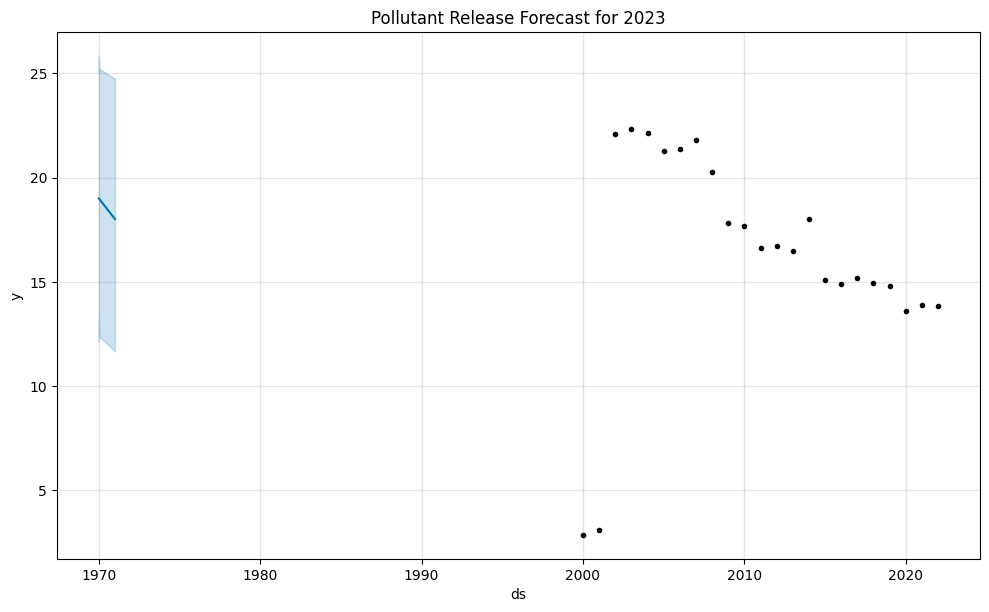

In [ ]:
#Time series analysis using Prophet
# Prepare the data for Prophet
df_time_series = df.groupby(['Reporting_Year / Année'])['Sum of release to all media (<1tonne)'].sum().reset_index()
df_time_series.columns = ['ds', 'y']  # Prophet expects column names as 'ds' for date and 'y' for value

# Initialize and fit the Prophet model
model = Prophet()
model.fit(df_time_series)

# Predict future values
future = model.make_future_dataframe(periods=1, freq='Y')  # Predict for 2023
forecast = model.predict(future)

# Plot forecast
model.plot(forecast)
plt.title('Pollutant Release Forecast for 2023')
plt.show()


In [ ]:
#Predict industry growth using regression models
industry_data = df.groupby(['NAICS Title / Titre Code_SCIAN', 'Reporting_Year / Année'])['Sum of release to all media (<1tonne)'].sum().reset_index()

# Pivot to get industries as columns
industry_pivot = industry_data.pivot(index='Reporting_Year / Année', columns='NAICS Title / Titre Code_SCIAN', values='Sum of release to all media (<1tonne)')

# Train a RandomForestRegressor for each industry
model_rf = RandomForestRegressor()
X = industry_pivot.index.values.reshape(-1, 1)  # Year as a feature
predictions = {}

for col in industry_pivot.columns:
    y = industry_pivot[col].fillna(0)  # Fill missing values
    model_rf.fit(X, y)
    predictions[col] = model_rf.predict([[2023]])  # Predict for 2023

# Display the predicted industries with the highest growth/decline
predictions_df = pd.DataFrame(predictions, index=['2023'])
predictions_df.T.sort_values(by='2023', ascending=False)


,2023
Oil and gas extraction (except oil sands),1.914383
Primary production of alumina and aluminum,1.814298
Mined oil sands extraction,1.228571
Fossil-fuel electric power generation,1.199854
Bituminous coal mining,0.970771
...,...
Retail Bakeries,0.000000
Other Specialty-Line Building Supplies Wholesaler-Distributors,0.000000
Residential Building Construction,0.000000
Hay Farming,0.000000
